<a href="https://colab.research.google.com/github/plaban1981/churn-prediction/blob/master/BUILDING_CHURN_MODEL.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

https://www.kdd.org/cupfiles/KDDCupData/2009/orange_large_train_churn.labels

In [3]:
from google.colab import files
files.upload()

Saving orange_small_test.data.zip to orange_small_test.data.zip


{'orange_small_test.data.zip': b'PK\x03\x04\x14\x00\x00\x00\x08\x00\xb2\\K:\x80\xdb*"-\xdc\x80\x00\x17\x1b\x90\x01\x16\x00\x15\x00orange_small_test.dataUT\t\x00\x03p\xaa\x92Iv/\x94IUx\x04\x00\xb4\x08\xec\x00\x9c\x9a\xd9r\xe2L\x90\x85\xafk"\xe6Q\x9a\xa8\xbdJ\x97`\xb3\x1a\x0c\xc6\x80\x81\x1b\x02\xcc\xbe\x180\x18\x03O?Y\x95B\x88\xc5\xee\xfeG\x17j\xb7M\n\xa1\xfc\xea\xe4\xc9,\x1a\xddOF\x1a\xddO\xeeN\xc2\x9d\xa4;)w\xd2\xeed\xdc\xc9\xbaS\xe0N\x8c\xfa\xb3\x8fa>\x88\xf9(\xe6\xc3\x98\x8fc>\x90\xf9H\xe6C\x99\x8f\xe5>\x96\xe3\xfb\xf9X\xeec\xb9\x8f\xe5>\x96\xfbX\xeec\xb9\x8f\xe5>V\xf8X\xe1c\x05\xde\xac\x8f\x15>V\xf8X\xe1c\x85\x8f\x15>V\xf8X\xe9c\xa5\x8f\x95>V\xe2\'\xf5\xb1\xd2\xc7J\x1f+}\xac\xf4\xb1\xd2\xc7*\x1f\xab|\xac\xf2\xb1\xca\xc7*|L>V\xf9X\xe5c\x95\x8fU>V\xfbX\xedc\xb5\x8f\xd5>V\xfbX\x8d\xcf\xd8\xc7j\x1f\xab}\xac\xf6\xb1\xc6\xc7\x1a\x1fk|\xac\xf1\xb1\xc6\xc7\x1a\x1fk0A>\xd6\xf8X\xe3c\xad\x8f\xb5>\xd6\xfaX\xebc\xad\x8f\xb5>\xd6\xfaX\x8b\xd9\xf5\xb1\xd6\xc7\x06>6\xf0\xb1\x81\x8f\r|l\xe0c\x03\x

## Unzip train and test data

In [0]:
!mkdir train_data

In [0]:
!mkdir test_data

In [6]:
!unzip orange_small_test.data.zip -d train_data

Archive:  orange_small_test.data.zip
  inflating: train_data/orange_small_test.data  
 extracting: train_data/orange_small_test.data.cksum  


In [7]:
!unzip orange_small_train.data.zip -d train_data

Archive:  orange_small_train.data.zip
  inflating: train_data/orange_small_train.data  
 extracting: train_data/orange_small_train.data.cksum  


## Descriptive Statistics of the training data

In [0]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [0]:
df = pd.read_csv('train_data/orange_small_train.data',sep='\t')

In [19]:
df.head()

,Var1,Var2,Var3,Var4,Var5,Var6,Var7,Var8,Var9,Var10,Var11,Var12,Var13,Var14,Var15,Var16,Var17,Var18,Var19,Var20,Var21,Var22,Var23,Var24,Var25,Var26,Var27,Var28,Var29,Var30,Var31,Var32,Var33,Var34,Var35,Var36,Var37,Var38,Var39,Var40,...,Var191,Var192,Var193,Var194,Var195,Var196,Var197,Var198,Var199,Var200,Var201,Var202,Var203,Var204,Var205,Var206,Var207,Var208,Var209,Var210,Var211,Var212,Var213,Var214,Var215,Var216,Var217,Var218,Var219,Var220,Var221,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229,Var230
0,NaN,NaN,NaN,NaN,NaN,1526.0,7.0,NaN,NaN,NaN,NaN,NaN,184.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,464.0,580.0,NaN,14.0,128.0,NaN,NaN,166.56,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,3570.0,NaN,NaN,...,NaN,bZkvyxLkBI,RO12,NaN,taul,1K8T,lK27,ka_ns41,nQUveAzAF7,NaN,NaN,dXGu,9_Y1,FbIm,VpdQ,haYg,me75fM6ugJ,kIsH,NaN,uKAI,L84s,XfqtO3UdzaXh_,NaN,NaN,NaN,XTbPUYD,sH5Z,cJvF,FzaX,1YVfGrO,oslk,fXVEsaq,jySVZNlOJy,NaN,NaN,xb3V,RAYp,F2FyR07IdsN7I,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,525.0,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,168.0,210.0,NaN,2.0,24.0,NaN,NaN,353.52,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,4764966.0,NaN,NaN,...,NaN,CEat0G8rTN,RO12,NaN,taul,1K8T,2Ix5,qEdASpP,y2LIM01bE1,NaN,NaN,lg1t,9_Y1,k13i,sJzTlal,zm5i,me75fM6ugJ,kIsH,NaN,uKAI,L84s,NhsEn4L,NaN,NaN,NaN,kZJyVg2,NaN,NaN,FzaX,0AJo2f2,oslk,2Kb5FSF,LM8l689qOp,NaN,NaN,fKCe,RAYp,F2FyR07IdsN7I,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,5236.0,7.0,NaN,NaN,NaN,NaN,NaN,904.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1212.0,1515.0,NaN,26.0,816.0,NaN,NaN,220.08,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,5883894.0,NaN,NaN,...,NaN,eOQt0GoOh3,AERks4l,SEuy,taul,1K8T,ffXs,NldASpP,y4g9XoZ,vynJTq9,smXZ,4bTR,9_Y1,MGOA,VpdQ,haYg,DHn_WUyBhW_whjA88g9bvA64_,kIsH,NaN,uKAI,L84s,UbxQ8lZ,NaN,TTGHfSv,NaN,pMWAe2U,bHR7,UYBR,FzaX,JFM1BiF,Al6ZaUT,NKv4yOc,jySVZNlOJy,NaN,kG3k,Qu4f,02N6s8f,ib5G6X1eUxUn6,am7c,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,22.08,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,...,NaN,jg69tYsGvO,RO12,NaN,taul,1K8T,ssAy,_ybO0dd,4hMlgkf58mhwh,NaN,NaN,W8mQ,9_Y1,YULl,VpdQ,NaN,me75fM6ugJ,kIsH,NaN,uKAI,Mtgm,NhsEn4L,NaN,NaN,NaN,kq0dQfu,eKej,UYBR,FzaX,L91KIiz,oslk,CE7uk3u,LM8l689qOp,NaN,NaN,FSa2,RAYp,F2FyR07IdsN7I,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,1029.0,7.0,NaN,NaN,NaN,NaN,NaN,3216.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,64.0,80.0,NaN,4.0,64.0,NaN,NaN,200.00,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,...,NaN,IXSgUHShse,RO12,SEuy,taul,1K8T,uNkU,EKR938I,ThrHXVS,0v21jmy,smXZ,xklU,9_Y1,RVjC,sJzTlal,6JmL,me75fM6ugJ,kIsH,NaN,uKAI,L84s,XfqtO3UdzaXh_,NaN,SJs3duv,NaN,11p4mKe,H3p7,UYBR,FzaX,OrnLfvc,oslk,1J2cvxe,LM8l689qOp,NaN,kG3k,FSa2,RAYp,F2FyR07IdsN7I,mj86,NaN


In [20]:
df.describe()

,Var1,Var2,Var3,Var4,Var5,Var6,Var7,Var8,Var9,Var10,Var11,Var12,Var13,Var14,Var15,Var16,Var17,Var18,Var19,Var20,Var21,Var22,Var23,Var24,Var25,Var26,Var27,Var28,Var29,Var30,Var31,Var32,Var33,Var34,Var35,Var36,Var37,Var38,Var39,Var40,...,Var153,Var154,Var155,Var156,Var157,Var158,Var159,Var160,Var161,Var162,Var163,Var164,Var165,Var166,Var167,Var168,Var169,Var170,Var171,Var172,Var173,Var174,Var175,Var176,Var177,Var178,Var179,Var180,Var181,Var182,Var183,Var184,Var185,Var186,Var187,Var188,Var189,Var190,Var209,Var230
count,702.000000,1241.000000,1240.000000,1579.000000,1.487000e+03,44471.000000,44461.000000,0.0,702.000000,1.487000e+03,1240.000000,558.000000,44461.000000,1240.000000,0.0,1487.000000,1579.000000,1579.000000,1579.000000,0.0,44471.000000,44991.000000,1487.000000,42770.000000,44991.000000,1487.000000,1487.000000,44989.000000,702.000000,702.000000,0.0,0.0,8.470000e+02,1241.000000,44991.000000,1.241000e+03,1.579000e+03,4.499100e+04,0.0,1241.000000,...,4.499100e+04,7.020000e+02,1579.00000,694.000000,1129.000000,873.000000,1241.000000,44991.000000,1579.000000,1.241000e+03,4.499100e+04,1579.000000,8.730000e+02,1487.000000,0.0,702.000000,0.0,1241.000000,1.083000e+03,1487.000000,44991.000000,1579.000000,0.0,1240.000000,1.241000e+03,646.000000,1579.000000,7.020000e+02,44991.000000,1.579000e+03,1.241000e+03,1241.000000,0.0,702.000000,702.00000,1241.000000,21022.000000,333.000000,0.0,0.0
mean,11.487179,0.004029,425.298387,0.125396,2.387933e+05,1326.437116,6.809496,NaN,48.145299,3.926057e+05,8.625806,16.071685,1249.688401,0.741935,NaN,120.239275,11.393287,7.215959,0.245092,NaN,234.518225,290.245382,7.535306,4.507926,96.827010,0.070612,0.028245,224.507669,0.022792,7.435897,NaN,NaN,1.270050e+05,1.173247,0.716810,1.595539e+05,6.485221e+05,2.579107e+06,NaN,13.962933,...,6.181967e+06,1.538221e+06,0.80114,169.472622,33.073516,1.896907,4.713940,38.803005,3.374288,3.360168e+05,4.860780e+05,1.753642,2.884236e+04,22.553463,NaN,332.938575,NaN,3.041096,3.674517e+05,9.744452,0.006846,7.044965,NaN,4.716129,6.188884e+05,16.687307,3.138062,3.776755e+06,0.611456,1.416638e+06,7.777380e+04,8.460919,NaN,3.299145,16.54416,167.368477,270.142137,22007.045192,NaN,NaN
std,40.709951,0.141933,4270.193518,1.275481,6.441259e+05,2685.693668,6.326053,NaN,154.777855,9.280896e+05,2.869558,64.185508,2794.954874,3.714316,NaN,72.386254,49.493856,34.415427,1.781497,NaN,565.560147,704.489990,49.449472,9.928819,214.318283,0.528836,0.247210,98.520240,0.212436,8.852461,NaN,NaN,4.957921e+05,4.377707,2.996007,3.277151e+05,1.382225e+06,3.010076e+06,NaN,81.410005,...,4.348926e+06,2.280224e+06,3.04295,544.686538,187.525494,6.325709,11.027292,99.497149,8.579672,9.731987e+05,8.488638e+05,8.104872,1.157869e+05,96.211261,NaN,102.879214,NaN,27.921735,6.042377e+05,10.397319,0.132503,36.186111,NaN,31.002253,1.306030e+06,59.016629,28.206035,3.785696e+06,2.495681,2.279786e+06,2.016188e+05,46.973777,NaN,8.781967,60.22303,113.980072,86.707692,29085.146490,NaN,NaN
min,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,NaN,0.000000,0.000000e+00,8.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-66.880000,0.000000,0.000000,NaN,NaN,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,NaN,0.000000,...,0.000000e+00,0.000000e+00,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,NaN,0.000000,NaN,0.000000,0.000000e+00,0.000000,0.000000,0.000000,NaN,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000,NaN,0.000000,0.00000,-6.420000,6.000000,0.000000,NaN,NaN
25%,0.000000,0.000000,0.000000,0.000000,0.000000e+00,518.000000,0.000000,NaN,4.000000,0.000000e+00,8.000000,0.000000,0.000000,0.000000,NaN,51.920000,0.000000,0.000000,0.000000,NaN,112.000000,135.000000,0.000000,0.000000,16.000000,0.000000,0.000000,166.560000,0.000000,0.000000,NaN,NaN,0.000000e+00,0.000000,0.0000

## Retrieving Labels for the training data

In [0]:
df_label = pd.read_csv('https://www.kdd.org/cupfiles/KDDCupData/2009/orange_large_train_churn.labels',header=None,names=['Churn'])

In [38]:
df_label.shape

(50000, 1)

In [39]:
df.shape

(50000, 230)

In [0]:
df_train = pd.concat([df,df_label],axis=1)

In [41]:
df_train.shape

(50000, 231)

In [45]:
df_train.head()

,Var1,Var2,Var3,Var4,Var5,Var6,Var7,Var8,Var9,Var10,Var11,Var12,Var13,Var14,Var15,Var16,Var17,Var18,Var19,Var20,Var21,Var22,Var23,Var24,Var25,Var26,Var27,Var28,Var29,Var30,Var31,Var32,Var33,Var34,Var35,Var36,Var37,Var38,Var39,Var40,...,Var192,Var193,Var194,Var195,Var196,Var197,Var198,Var199,Var200,Var201,Var202,Var203,Var204,Var205,Var206,Var207,Var208,Var209,Var210,Var211,Var212,Var213,Var214,Var215,Var216,Var217,Var218,Var219,Var220,Var221,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229,Var230,Churn
0,NaN,NaN,NaN,NaN,NaN,1526.0,7.0,NaN,NaN,NaN,NaN,NaN,184.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,464.0,580.0,NaN,14.0,128.0,NaN,NaN,166.56,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,3570.0,NaN,NaN,...,bZkvyxLkBI,RO12,NaN,taul,1K8T,lK27,ka_ns41,nQUveAzAF7,NaN,NaN,dXGu,9_Y1,FbIm,VpdQ,haYg,me75fM6ugJ,kIsH,NaN,uKAI,L84s,XfqtO3UdzaXh_,NaN,NaN,NaN,XTbPUYD,sH5Z,cJvF,FzaX,1YVfGrO,oslk,fXVEsaq,jySVZNlOJy,NaN,NaN,xb3V,RAYp,F2FyR07IdsN7I,NaN,NaN,-1
1,NaN,NaN,NaN,NaN,NaN,525.0,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,168.0,210.0,NaN,2.0,24.0,NaN,NaN,353.52,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,4764966.0,NaN,NaN,...,CEat0G8rTN,RO12,NaN,taul,1K8T,2Ix5,qEdASpP,y2LIM01bE1,NaN,NaN,lg1t,9_Y1,k13i,sJzTlal,zm5i,me75fM6ugJ,kIsH,NaN,uKAI,L84s,NhsEn4L,NaN,NaN,NaN,kZJyVg2,NaN,NaN,FzaX,0AJo2f2,oslk,2Kb5FSF,LM8l689qOp,NaN,NaN,fKCe,RAYp,F2FyR07IdsN7I,NaN,NaN,-1
2,NaN,NaN,NaN,NaN,NaN,5236.0,7.0,NaN,NaN,NaN,NaN,NaN,904.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1212.0,1515.0,NaN,26.0,816.0,NaN,NaN,220.08,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,5883894.0,NaN,NaN,...,eOQt0GoOh3,AERks4l,SEuy,taul,1K8T,ffXs,NldASpP,y4g9XoZ,vynJTq9,smXZ,4bTR,9_Y1,MGOA,VpdQ,haYg,DHn_WUyBhW_whjA88g9bvA64_,kIsH,NaN,uKAI,L84s,UbxQ8lZ,NaN,TTGHfSv,NaN,pMWAe2U,bHR7,UYBR,FzaX,JFM1BiF,Al6ZaUT,NKv4yOc,jySVZNlOJy,NaN,kG3k,Qu4f,02N6s8f,ib5G6X1eUxUn6,am7c,NaN,-1
3,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,22.08,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,...,jg69tYsGvO,RO12,NaN,taul,1K8T,ssAy,_ybO0dd,4hMlgkf58mhwh,NaN,NaN,W8mQ,9_Y1,YULl,VpdQ,NaN,me75fM6ugJ,kIsH,NaN,uKAI,Mtgm,NhsEn4L,NaN,NaN,NaN,kq0dQfu,eKej,UYBR,FzaX,L91KIiz,oslk,CE7uk3u,LM8l689qOp,NaN,NaN,FSa2,RAYp,F2FyR07IdsN7I,NaN,NaN,-1
4,NaN,NaN,NaN,NaN,NaN,1029.0,7.0,NaN,NaN,NaN,NaN,NaN,3216.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,64.0,80.0,NaN,4.0,64.0,NaN,NaN,200.00,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,...,IXSgUHShse,RO12,SEuy,taul,1K8T,uNkU,EKR938I,ThrHXVS,0v21jmy,smXZ,xklU,9_Y1,RVjC,sJzTlal,6JmL,me75fM6ugJ,kIsH,NaN,uKAI,L84s,XfqtO3UdzaXh_,NaN,SJs3duv,NaN,11p4mKe,H3p7,UYBR,FzaX,OrnLfvc,oslk,1J2cvxe,LM8l689qOp,NaN,kG3k,FSa2,RAYp,F2FyR07IdsN7I,mj86,NaN,1


## Data Preprocessing and Feature Selection

In [0]:
numeric = []
categorical =  []
for i in df_train.columns:
  if df_train[i].dtypes == 'object':
    categorical.append(i)
  else:
    numeric.append(i)

In [47]:
print(len(categorical))
print(len(numeric))

38
193


In [48]:
df.describe(include='O')

,Var191,Var192,Var193,Var194,Var195,Var196,Var197,Var198,Var199,Var200,Var201,Var202,Var203,Var204,Var205,Var206,Var207,Var208,Var210,Var211,Var212,Var213,Var214,Var215,Var216,Var217,Var218,Var219,Var220,Var221,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229
count,1083,49631,50000,12784,50000,50000,49857,50000,49996,24592,12783,49999,49857,50000,48066,44471,50000,49857,50000,50000,50000,1129,24592,694,50000,49297,49297,44789,50000,50000,50000,44789,820,23856,50000,50000,50000,21568
unique,1,361,51,3,23,4,225,4291,5073,15415,2,5713,5,100,3,21,14,2,6,2,81,1,15415,1,2016,13990,2,22,4291,7,4291,4,1,3,23,7,30,4
top,r__I,qFpmfo8zhV,RO12,SEuy,taul,1K8T,0Xwj,fhk21Ss,r83_sZi,yP09M03,smXZ,nyZz,9_Y1,RVjC,VpdQ,IYzP,me75fM6ugJ,kIsH,uKAI,L84s,NhsEn4L,KdSa,5zARyjR,eGzu,mAjbk_S,gvA6,cJvF,FzaX,4UxGlow,oslk,catzS2D,LM8l689qOp,4n2X,ELof,FSa2,RAYp,F2FyR07IdsN7I,am7c
freq,1083,385,35964,12567,47958,49550,4629,4441,955,73,12777,198,45233,1819,31962,17274,35079,46022,47570,40299,29303,1129,73,694,4937,283,25319,40304,4441,37009,4441,36608,820,11072,8031,35156,32703,11689


## Data Preprocessing and Feature Selection

#### Filling missing values with 0 for all numeric datatype

In [0]:
df_train[numeric] = df_train[numeric].fillna(0)

In [52]:
df_train.head()

,Var1,Var2,Var3,Var4,Var5,Var6,Var7,Var8,Var9,Var10,Var11,Var12,Var13,Var14,Var15,Var16,Var17,Var18,Var19,Var20,Var21,Var22,Var23,Var24,Var25,Var26,Var27,Var28,Var29,Var30,Var31,Var32,Var33,Var34,Var35,Var36,Var37,Var38,Var39,Var40,...,Var192,Var193,Var194,Var195,Var196,Var197,Var198,Var199,Var200,Var201,Var202,Var203,Var204,Var205,Var206,Var207,Var208,Var209,Var210,Var211,Var212,Var213,Var214,Var215,Var216,Var217,Var218,Var219,Var220,Var221,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229,Var230,Churn
0,0.0,0.0,0.0,0.0,0.0,1526.0,7.0,0.0,0.0,0.0,0.0,0.0,184.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,464.0,580.0,0.0,14.0,128.0,0.0,0.0,166.56,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3570.0,0.0,0.0,...,bZkvyxLkBI,RO12,NaN,taul,1K8T,lK27,ka_ns41,nQUveAzAF7,NaN,NaN,dXGu,9_Y1,FbIm,VpdQ,haYg,me75fM6ugJ,kIsH,0.0,uKAI,L84s,XfqtO3UdzaXh_,NaN,NaN,NaN,XTbPUYD,sH5Z,cJvF,FzaX,1YVfGrO,oslk,fXVEsaq,jySVZNlOJy,NaN,NaN,xb3V,RAYp,F2FyR07IdsN7I,NaN,0.0,-1
1,0.0,0.0,0.0,0.0,0.0,525.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,168.0,210.0,0.0,2.0,24.0,0.0,0.0,353.52,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4764966.0,0.0,0.0,...,CEat0G8rTN,RO12,NaN,taul,1K8T,2Ix5,qEdASpP,y2LIM01bE1,NaN,NaN,lg1t,9_Y1,k13i,sJzTlal,zm5i,me75fM6ugJ,kIsH,0.0,uKAI,L84s,NhsEn4L,NaN,NaN,NaN,kZJyVg2,NaN,NaN,FzaX,0AJo2f2,oslk,2Kb5FSF,LM8l689qOp,NaN,NaN,fKCe,RAYp,F2FyR07IdsN7I,NaN,0.0,-1
2,0.0,0.0,0.0,0.0,0.0,5236.0,7.0,0.0,0.0,0.0,0.0,0.0,904.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1212.0,1515.0,0.0,26.0,816.0,0.0,0.0,220.08,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5883894.0,0.0,0.0,...,eOQt0GoOh3,AERks4l,SEuy,taul,1K8T,ffXs,NldASpP,y4g9XoZ,vynJTq9,smXZ,4bTR,9_Y1,MGOA,VpdQ,haYg,DHn_WUyBhW_whjA88g9bvA64_,kIsH,0.0,uKAI,L84s,UbxQ8lZ,NaN,TTGHfSv,NaN,pMWAe2U,bHR7,UYBR,FzaX,JFM1BiF,Al6ZaUT,NKv4yOc,jySVZNlOJy,NaN,kG3k,Qu4f,02N6s8f,ib5G6X1eUxUn6,am7c,0.0,-1
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,22.08,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,jg69tYsGvO,RO12,NaN,taul,1K8T,ssAy,_ybO0dd,4hMlgkf58mhwh,NaN,NaN,W8mQ,9_Y1,YULl,VpdQ,NaN,me75fM6ugJ,kIsH,0.0,uKAI,Mtgm,NhsEn4L,NaN,NaN,NaN,kq0dQfu,eKej,UYBR,FzaX,L91KIiz,oslk,CE7uk3u,LM8l689qOp,NaN,NaN,FSa2,RAYp,F2FyR07IdsN7I,NaN,0.0,-1
4,0.0,0.0,0.0,0.0,0.0,1029.0,7.0,0.0,0.0,0.0,0.0,0.0,3216.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64.0,80.0,0.0,4.0,64.0,0.0,0.0,200.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,IXSgUHShse,RO12,SEuy,taul,1K8T,uNkU,EKR938I,ThrHXVS,0v21jmy,smXZ,xklU,9_Y1,RVjC,sJzTlal,6JmL,me75fM6ugJ,kIsH,0.0,uKAI,L84s,XfqtO3UdzaXh_,NaN,SJs3duv,NaN,11p4mKe,H3p7,UYBR,FzaX,OrnLfvc,oslk,1J2cvxe,LM8l689qOp,NaN,kG3k,FSa2,RAYp,F2FyR07IdsN7I,mj86,0.0,1


In [0]:
df_train[categorical] = df_train[categorical].fillna(0)

## Check if any null values exist after replacing null values with 0

In [60]:
df_train.isnull().sum()[df_train.isnull().sum() > 0]

Series([], dtype: int64)

## Converting Categorical values  into numeric values

In [0]:
from sklearn.preprocessing import LabelEncoder
lb = LabelEncoder()
for i in categorical :
  df_train[i] = lb.fit_transform(df_train[i].astype('str'))


In [68]:
df_train[categorical].head()

,Var191,Var192,Var193,Var194,Var195,Var196,Var197,Var198,Var199,Var200,Var201,Var202,Var203,Var204,Var205,Var206,Var207,Var208,Var210,Var211,Var212,Var213,Var214,Var215,Var216,Var217,Var218,Var219,Var220,Var221,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229
0,0,142,18,0,15,0,88,2561,3354,0,0,2983,1,21,2,4,2,1,5,0,39,0,0,0,1781,2489,2,4,4225,4,2184,4,0,0,15,2,28,0
1,0,354,18,0,15,0,46,2998,4325,0,0,3806,1,77,3,14,2,1,5,0,27,0,0,0,355,0,0,4,2,4,280,1,0,0,6,2,28,0
2,0,167,45,2,15,0,66,764,4337,5031,2,3879,1,31,2,4,9,1,5,0,37,0,12321,0,683,12297,1,4,328,0,681,4,0,2,2,0,18,1
3,0,191,18,0,15,0,117,1752,2924,0,0,2173,1,53,2,0,2,1,5,1,27,0,0,0,475,13062,1,4,496,4,4089,1,0,0,20,2,28,0
4,0,38,18,2,15,0,123,4260,1559,7085,2,5016,1,38,3,16,2,1,5,0,39,0,12032,0,1572,7143,1,4,815,4,3903,1,0,2,20,2,28,2


## Normalizing the features

In [0]:
X = df_train.drop('Churn',axis=1)
Y = df_train['Churn']

In [0]:
from sklearn.preprocessing import MinMaxScaler
mn = MinMaxScaler()
X_scaled = mn.fit_transform(X)
Y_scaled = Y.values

In [71]:
print(X_scaled.shape)
print(Y_scaled.shape)

(50000, 230)
(50000,)


## Split the dataset into training and validation set

In [0]:
from sklearn.model_selection import train_test_split
X_train,X_valid,y_train,y_valid = train_test_split(X_scaled,Y_scaled,test_size=0.2,random_state=1)

 ## Applying RandomForest Classification

In [75]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier(n_estimators=100)
rf.fit(X_train,y_train)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
                       max_depth=None, max_features='auto', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

## Predictions

In [0]:
y_valid_pred = rf.predict(X_valid)

## Accuracy of the model

In [77]:
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
print(f'Accuracy Score = {np.round(accuracy_score(y_valid,y_valid_pred)*100.0,2)}%')

Accuracy Score = 92.54%


In [0]:
cm = confusion_matrix(y_valid,y_valid_pred)

In [90]:
print(classification_report(y_valid,y_valid_pred))

              precision    recall  f1-score   support

          -1       0.93      1.00      0.96      9254
           1       0.00      0.00      0.00       746

    accuracy                           0.93     10000
   macro avg       0.46      0.50      0.48     10000
weighted avg       0.86      0.93      0.89     10000



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


In [88]:
cm

array([[9254,  746],
       [   0,    0]])

In [84]:
cm_df = pd.DataFrame(cm,index=['No Churn','Churn'],columns=['No Churn','Churn'])
print(cm_df)

          No Churn  Churn
No Churn      9254      0
Churn          746      0


Text(33.0, 0.5, 'Actual')

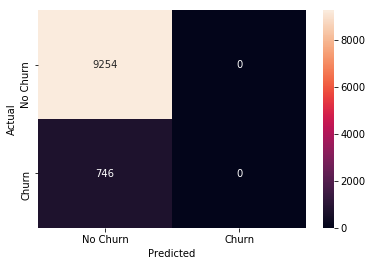

In [92]:
sns.heatmap(cm_df,annot=True,fmt='g')
plt.xlabel('Predicted')
plt.ylabel('Actual')

## Preprocessing Test Data in order for the model to predict the labels

In [0]:
df_test= pd.read_csv('train_data/orange_small_test.data',sep='\t')
test = df_test.copy()

In [100]:
df_test.shape

(50000, 230)

## filling null values with 0

In [0]:
df_test = df_test.fillna(0)

## Label Encoding Categorical values 

In [0]:
for i in categorical:
    df_test[i] = lb.fit_transform(df_test[i].astype('str'))

## Test Data Normalization

In [0]:
test_scaled = mn.fit_transform(df_test)

## Predictions

In [0]:
predictions = rf.predict(test_scaled)

## Creating a Churn attribute for the test data 

In [0]:
test['Churn'] = predictions

In [106]:
test.head()

,Var1,Var2,Var3,Var4,Var5,Var6,Var7,Var8,Var9,Var10,Var11,Var12,Var13,Var14,Var15,Var16,Var17,Var18,Var19,Var20,Var21,Var22,Var23,Var24,Var25,Var26,Var27,Var28,Var29,Var30,Var31,Var32,Var33,Var34,Var35,Var36,Var37,Var38,Var39,Var40,...,Var192,Var193,Var194,Var195,Var196,Var197,Var198,Var199,Var200,Var201,Var202,Var203,Var204,Var205,Var206,Var207,Var208,Var209,Var210,Var211,Var212,Var213,Var214,Var215,Var216,Var217,Var218,Var219,Var220,Var221,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229,Var230,Churn
0,NaN,NaN,NaN,NaN,NaN,1225.0,7.0,NaN,NaN,NaN,NaN,NaN,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,156.0,195.0,NaN,0.0,72.0,NaN,NaN,166.56,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,4259232.0,NaN,NaN,...,xddq9ayfAo,RO12,NaN,taul,1K8T,PShj,iJzviRg,17VONbZnAuZ90atz,MF5EBmj,NaN,WVvO,9_Y1,vm5R,VpdQ,haYg,7M47J5GA0pTYIFxg5uy,kIsH,NaN,uKAI,L84s,H4p93_uThXwSG,NaN,XREFJCi,NaN,7WwzJJY,OgPm,cJvF,FzaX,ch2oGfM,Al6ZaUT,P6pu4Vl,LM8l689qOp,NaN,ELof,7P5s,ZI9m,R4y5gQQWY8OodqDV,NaN,NaN,-1
1,NaN,NaN,NaN,NaN,NaN,259.0,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,192.0,240.0,NaN,0.0,40.0,NaN,NaN,300.32,NaN,NaN,NaN,NaN,NaN,NaN,5.0,NaN,NaN,4859550.0,NaN,NaN,...,cFHt0GoOh3,RO12,NaN,taul,1K8T,lK27,rsmctTK,7ONkRNQCK7,NaN,NaN,aFB2,9_Y1,t_4G,VpdQ,zm5i,me75fM6ugJ,kIsH,NaN,uKAI,L84s,NhsEn4L,NaN,NaN,NaN,kZJyVg2,4ls8,cJvF,FzaX,Kgofc8E,oslk,S46Rt72,LM8l689qOp,NaN,NaN,Qu4f,RAYp,F2FyR07IdsN7I,NaN,NaN,-1
2,NaN,NaN,NaN,NaN,NaN,861.0,14.0,NaN,NaN,NaN,NaN,NaN,236.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32.0,40.0,NaN,0.0,8.0,NaN,NaN,186.64,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,10038840.0,NaN,NaN,...,zcROj17IEC,RO12,NaN,taul,1K8T,oXaB,I6Bd3iM,bGUqwlz,NaN,NaN,6k5I,9_Y1,iVbl,VpdQ,zm5i,me75fM6ugJ,kIsH,NaN,uKAI,L84s,NhsEn4L,NaN,NaN,NaN,kZJtVhC,0b0w,cJvF,FzaX,bBmOw16,oslk,CcdTy9x,LM8l689qOp,NaN,NaN,7aLG,RAYp,F2FyR07IdsN7I,NaN,NaN,-1
3,NaN,NaN,NaN,NaN,NaN,1568.0,7.0,NaN,NaN,NaN,NaN,NaN,1232.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,448.0,560.0,NaN,4.0,88.0,NaN,NaN,166.56,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,116760.0,NaN,NaN,...,gOyq9ayE15,2Knk1KF,SEuy,taul,1K8T,tzKK,Te2s8CN,hOpRIhsUSP,x0xpMjN,smXZ,kVZt,9_Y1,vm5R,VpdQ,6JmL,me75fM6ugJ,kIsH,NaN,uKAI,L84s,XfqtO3UdzaXh_,NaN,3yoa8Yv,NaN,XTbPUYD,XqfQ,UYBR,AU8pNoi,rDm6pd1,oslk,Q53Rkup,LM8l689qOp,NaN,kG3k,7P5s,RAYp,TCU50_Yjmm6GIBZ0lL_,am7c,NaN,-1
4,NaN,NaN,NaN,NaN,NaN,1197.0,7.0,NaN,NaN,NaN,NaN,NaN,204.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,100.0,125.0,NaN,8.0,40.0,NaN,NaN,133.12,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,257772.0,NaN,NaN,...,voArjIXt5a,onTuEhrJJQy_H3IHkZku5AFczhYGqxJ890,NaN,taul,1K8T,80HR,fqeOwLG,nJy8d8N5V7yiy,IBmPo7a,NaN,oyu5,9_Y1,WIr3,VpdQ,kxE9,7M47J5GA0pTYIFxg5uy,kIsH,NaN,uKAI,L84s,H4p93_uThXwSG,NaN,c02HCHI,NaN,_JdEa95,bOvW,cJvF,FzaX,fxJmel6,Al6ZaUT,WfsWw2A,LM8l689qOp,NaN,ELof,5Acm,ZI9m,iyHGyLCEkQ,am7c,NaN,-1
